In [1]:
import torch
import cv2
from segment_anything import SamAutomaticMaskGenerator, sam_model_registry, SamPredictor
import numpy as np
import matplotlib.pyplot as plt
import glob
import torch
import clip
from PIL import Image
from tqdm import tqdm
import functions as fnc
from importlib import reload
from sklearn.cluster import KMeans
from scipy.ndimage import rotate
from scipy.spatial import ConvexHull, convex_hull_plot_2d
import gc
from skimage.measure import label, regionprops

In [2]:
OutDIR='/DATA/vito/output/'
DataDIR='/DATA/vito/data/'
MODEL_TYPE = "vit_h"

if torch.cuda.is_available():
    DEVICE = torch.device('cuda:0')
    print('Currently running on GPU\nModel '+MODEL_TYPE)
else:
    DEVICE = torch.device('cpu')
    print('Currently running on CPU\nModel '+MODEL_TYPE)

if MODEL_TYPE == 'vit_h':
    CHECKPOINT_PATH = DataDIR+'MetaSAM/sam_vit_h_4b8939.pth'
elif MODEL_TYPE == 'vit_l':
    CHECKPOINT_PATH = DataDIR+'MetaSAM/sam_vit_l_0b3195.pth'
else:
    CHECKPOINT_PATH = DataDIR+'MetaSAM/sam_vit_b_01ec64.pth'

sam = sam_model_registry[MODEL_TYPE](checkpoint=CHECKPOINT_PATH)
sam.to(device=DEVICE)
mask_generator = SamAutomaticMaskGenerator(sam)


Currently running on GPU
Model vit_h


In [3]:
#fn_img = glob.glob(DataDIR+'test_img/*')
fn_img = glob.glob(DataDIR+'drone_ortho/*')
fn_img.sort()
print('Available images:')
for i, fn in enumerate(fn_img):
    print(f'{i}:' + fn.split("/")[-1])
print("---------------")


Available images:
0:512patched_LaPaya.npy
1:512patched_mask.npy
2:LaPaya_Apr2024_03May24_orthomosaic_5cm_UTM19S_WGS84.tif
3:LaPaya_Apr2024_orthomosaic_5cm_UTM19S_WGS84.tif
4:Ravi1_Orthomosaic_0.2mm.tif
5:Ravi2_Orthomosaic_0.2mm.tif
6:Ravi2_Orthomosaic_0.2mm_clip1.tif
7:Ravi3_Orthomosaic_0.2mm.tif
8:big_clip.tif
9:small_clip1.tif
10:small_clip2.tif
---------------


In [6]:
img_select=int(input("Select a image: "))
image = cv2.imread(fn_img[img_select])
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
print(fn_img[img_select].split("/")[-1]+' imported')
print('Image size:', image.shape)

Ravi2_Orthomosaic_0.2mm_clip1.tif imported
Image size: (2680, 5125, 3)


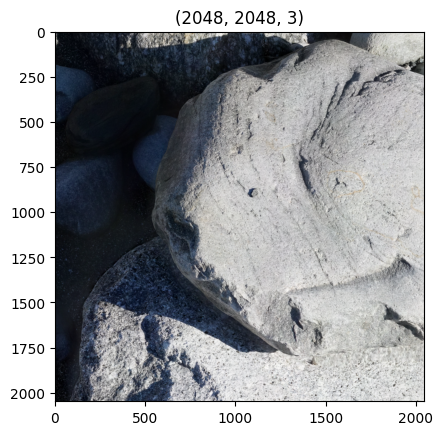

In [48]:
crop_size=2048
i,j=0,0#1,2
cropped_image=image[crop_size*i:crop_size*(i+1),crop_size*j:crop_size*(j+1),:]
plt.imshow(cropped_image)
plt.title(f'{cropped_image.shape}')
plt.show()

In [54]:
def crop_fnc(input, para_in):
    para={'crop size': 2048,
          'i':0,
          'j':0}
    para.update(para_in)
    crop_size=para.get('crop size')
    i=para.get('i')
    j=para.get('j')
    output = input[crop_size*i:crop_size*(i+1),crop_size*j:crop_size*(j+1),:]
    return output
def gaussian_fnc(input, para_in):
    para={'kernel size': 3}
    para.update(para_in)
    k=para.get('kernel size')

    output = cv2.GaussianBlur(input, (k, k), k/6) 
    return output

def clahe_fnc(input, para_in):
    para={'clahe window': 50,
            'clip limit': 4
            }
    para.update(para_in)

    clahe_ws=para.get('clahe window')
    clip_limit=para.get('clip limit')

    lab_image = cv2.cvtColor(input, cv2.COLOR_RGB2LAB)
    l_channel, a_channel, b_channel = cv2.split(lab_image)
    xysize=input.shape[:-1]
    
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=(xysize[0]//clahe_ws,xysize[1]//clahe_ws))#84, 3-512
    cl_channel = clahe.apply(l_channel)

    merged_lab = cv2.merge([cl_channel, a_channel, b_channel])
    output = cv2.cvtColor(merged_lab, cv2.COLOR_LAB2RGB)
    return output

def Lpull_fnc(input, para_in):
    para={'thres': 60,
          'pull': 60
          }
    para.update(para_in)

    thres=para.get('thres')
    pull=para.get('pull')

    lab_image = cv2.cvtColor(input, cv2.COLOR_RGB2LAB)
    l_channel, a_channel, b_channel = cv2.split(lab_image)
    cl_channel = l_channel.copy()
    cl_channel[cl_channel<thres]+=pull

    merged_lab = cv2.merge([cl_channel, a_channel, b_channel])
    output = cv2.cvtColor(merged_lab, cv2.COLOR_LAB2RGB)
    return output

def downsample_fnc(input, para_in):
    para={'fxy':2,
          'inter_area': None}
    para.update(para_in)

    fxy=para.get('fxy')
    if para.get('inter_area'):
        output=cv2.resize(input, (0, 0), fx = fxy, fy = fxy, interpolation = cv2.INTER_AREA)
    else:
        output=cv2.resize(input, (0, 0), fx = fxy, fy = fxy)
    return output


def load_roulette(input, process, para_in):
    if process=='Crop':
        output=crop_fnc(input, para_in)
    elif process=='Gaussian':
        output = gaussian_fnc(input, para_in)
    elif process=='CLAHE':
        output = clahe_fnc(input,para_in)
    elif process=='Lpull':
        output = Lpull_fnc(input,para_in)
    elif process=='Downsample':
        output = downsample_fnc(input,para_in)
    else:
        print('No process performed, returning input')
        output=input
    return output
def preprocessing_roulette(input, process_para):
    '''
    Crop:
    para={'crop size': 2048,
          'i':0,
          'j':0}

    Gaussian:
    para={'kernel size': 3}

    CLAHE:
    para={'clahe window': 50,
            'clip limit': 4}

    Lpull:
    para={'thres': 60,
          'pull': 60}

    Downsample:
    para={'fxy':2,
          'inter_area': None}
    '''
    temp_input = input.copy()
    for process, para in process_para.items():
        temp_input=load_roulette(temp_input,process,para)
    return temp_input

#automize to search for parameter that generates most mask without upping the maximum overlap above a certain value?

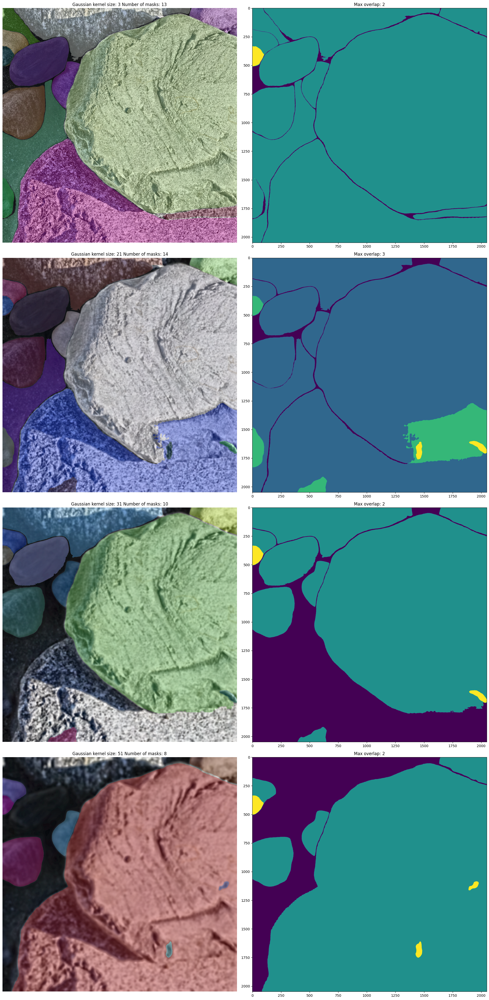

In [52]:
var='Gaussian kernel size'
crop_size=2048
ci=0
test=[3,21,31,51]
sigma=10
temp_image=cropped_image#image#clahe_image

fig, ax = plt.subplots(len(test),2,figsize=(20,40))
ax=ax.flatten()

#build generator
for i in np.arange(0,len(test),1):
    cj=test[i]
    #Gaussian = cv2.GaussianBlur(cropped_image, (cj, cj), cj/6) 
    #Gaussian = load_roulette(cropped_image, 'Gaussian', {'kernel size':cj})
    Gaussian = fnc.preprocessing_roulette(cropped_image, {'Gaussian': {'kernel size':cj},'CLAHE':{'clip limit':3}})

    #refresh memory
    gc.collect()
    torch.cuda.empty_cache()
    
    mask_generator = SamAutomaticMaskGenerator(
        model=sam,
        points_per_side=12,
        pred_iou_thresh=0.9,
        stability_score_thresh=0.95,#iou by varying cutoff in binary conversion
        box_nms_thresh=0.3,#The box IoU cutoff used by non-maximal suppression to filter duplicate masks
        crop_n_layers=0,#cut into 2**n crops
        crop_nms_thresh=0,#The box IoU cutoff used by non-maximal suppression to filter duplicate masks between crops
        crop_n_points_downscale_factor=1,
        crop_overlap_ratio=0,
        min_mask_region_area=2000,
    )
    with torch.no_grad():
        masks = mask_generator.generate(Gaussian)
    ax[i*2].imshow(Gaussian)
    fnc.show_anns_mod_ax(masks, ax[i*2])
    ax[i*2].set_title(f'{var}: {test[i]} Number of masks: {len(masks)}')
    ax[i*2].axis('off')
    list_of_masks = [mask['segmentation'].astype(np.uint8) for mask in masks]
    ar_masks=np.stack(list_of_masks) 
    ax[i*2+1].imshow(np.sum(ar_masks,axis=0))
    ax[i*2+1].set_title(f'Max overlap: {np.unique(np.sum(ar_masks,axis=0)).max()}')       
plt.tight_layout()
plt.show()

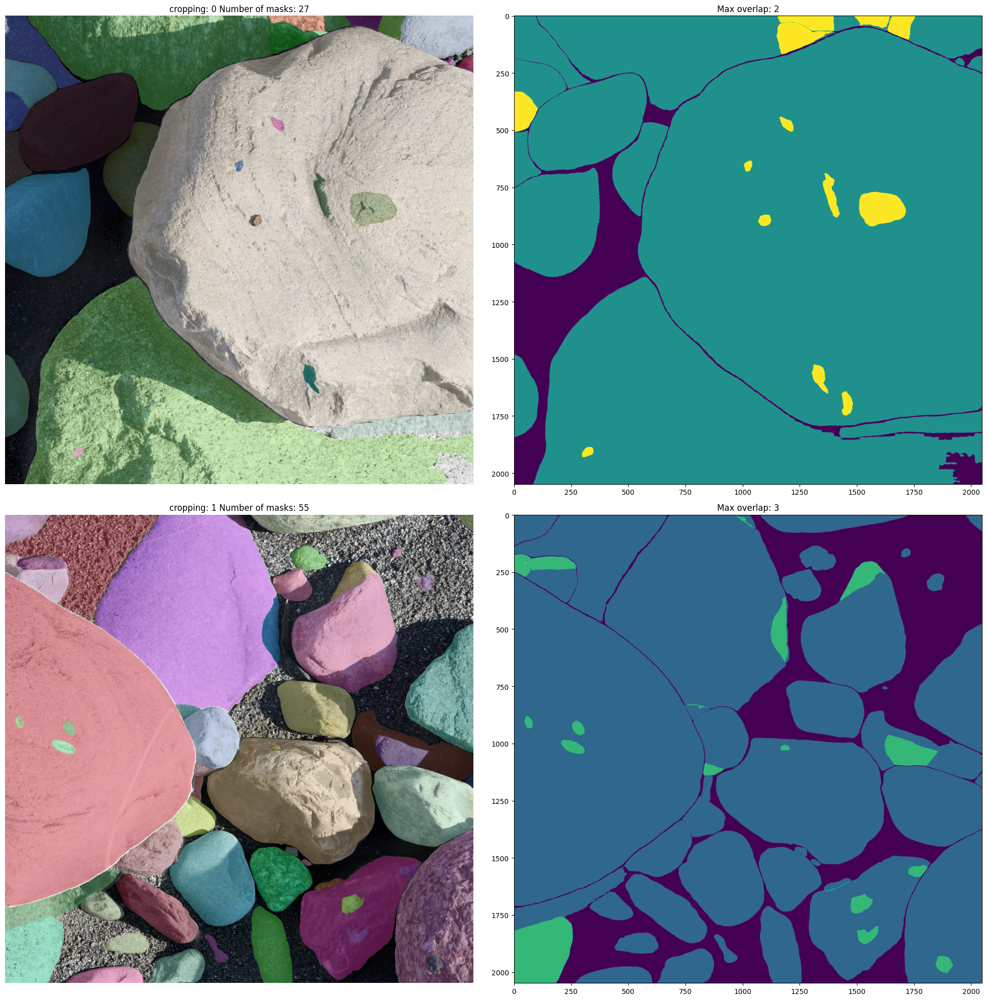

In [10]:
var='cropping'
crop_size=2048
ci=0
test=[0,1]
temp_image=Gaussian#image#clahe_image

fig, ax = plt.subplots(len(test),2,figsize=(20,20))
ax=ax.flatten()

#build generator
for i in np.arange(0,len(test),1):
    cj=test[i]
    cropped_image=image[crop_size*ci:crop_size*(ci+1),crop_size*cj:crop_size*(cj+1),:]
    
    #refresh memory
    gc.collect()
    torch.cuda.empty_cache()
    
    mask_generator = SamAutomaticMaskGenerator(
        model=sam,
        points_per_side=64,
        pred_iou_thresh=0.9,
        stability_score_thresh=0.95,#iou by varying cutoff in binary conversion
        box_nms_thresh=0.3,#The box IoU cutoff used by non-maximal suppression to filter duplicate masks
        crop_n_layers=0,#cut into 2**n crops
        crop_nms_thresh=0,#The box IoU cutoff used by non-maximal suppression to filter duplicate masks between crops
        crop_n_points_downscale_factor=1,
        crop_overlap_ratio=0,
        min_mask_region_area=2000,
    )
    with torch.no_grad():
        masks = mask_generator.generate(cropped_image)
    ax[i*2].imshow(cropped_image)
    fnc.show_anns_mod_ax(masks, ax[i*2])
    ax[i*2].set_title(f'{var}: {test[i]} Number of masks: {len(masks)}')
    ax[i*2].axis('off')
    list_of_masks = [mask['segmentation'].astype(np.uint8) for mask in masks]
    ar_masks=np.stack(list_of_masks) 
    ax[i*2+1].imshow(np.sum(ar_masks,axis=0))
    ax[i*2+1].set_title(f'Max overlap: {np.unique(np.sum(ar_masks,axis=0)).max()}')       
plt.tight_layout()
plt.show()

In [32]:
img2D = cropped_image.reshape(crop_size**2,3)
kmeans_model = KMeans(n_clusters=2)
cluster_labels = kmeans_model.fit_predict(img2D)

/DATA/vito/.venv/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


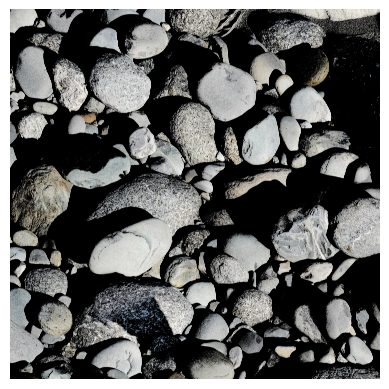

In [35]:
kmean_mask=np.array(np.reshape(cluster_labels,(crop_size,crop_size)) == 0)
kmean_masked_img=cropped_image.copy()
kmean_masked_img[kmean_mask==0]=0
plt.imshow(kmean_masked_img)
plt.axis('off')
plt.show()

In [ ]:
"--points-per-side" "Generate masks by sampling a grid over the image with this many points to a side."
"--points-per-batch" "How many input points to process simultaneously in one batch."
"--pred-iou-thresh" "Exclude masks with a predicted score from the model that is lower than this threshold."
"--stability-score-thresh" "Exclude masks with a stability score lower than this threshold."
"--stability-score-offset" "Larger values perturb the mask more when measuring stability score."
"--box-nms-thresh" "The overlap threshold for excluding a duplicate mask."
"--crop-n-layers" 
    "If >0, mask generation is run on smaller crops of the image to generate more masks. "
    "The value sets how many different scales to crop at."
"--crop-nms-thresh" "The overlap threshold for excluding duplicate masks across different crops."
"--crop-overlap-ratio" "Larger numbers mean image crops will overlap more."
"--crop-n-points-downscale-factor" "The number of points-per-side in each layer of crop is reduced by this factor."
"--min-mask-region-area"
    "Disconnected mask regions or holes with area smaller than this value "
    "in pixels are removed by postprocessing."

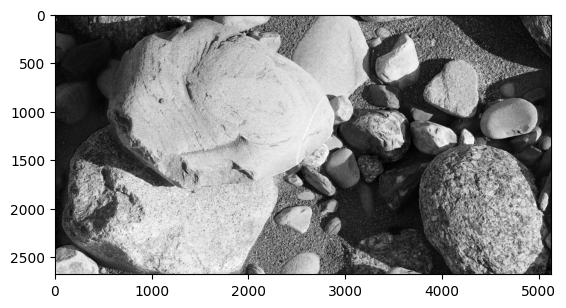

In [11]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
gray = np.expand_dims(gray, axis=2)
gray = np.repeat(gray, 3, axis=2)
plt.imshow(gray)

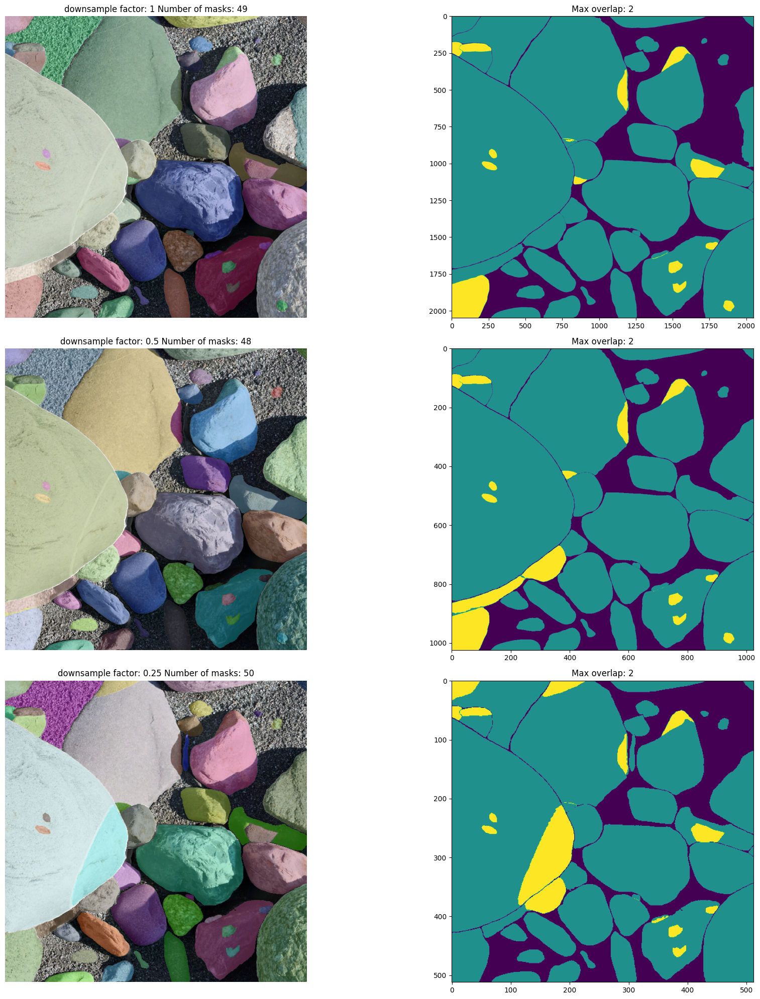

In [25]:
var='downsample factor'
test=[1,1/2,1/4]

crop_size=2048
ci,cj=0,1
cropped_image=image[crop_size*ci:crop_size*(ci+1),crop_size*cj:crop_size*(cj+1),:]
temp_image=cropped_image#clahe_image

fig, ax = plt.subplots(len(test),2,figsize=(20,20))
ax=ax.flatten()

#build generator
for i in np.arange(0,len(test),1):
    fxy=test[i]
    shrinked_image=cv2.resize(temp_image, (0, 0), fx = fxy, fy = fxy)#, interpolation = cv2.INTER_AREA)
    
    #refresh memory
    gc.collect()
    torch.cuda.empty_cache()
    
    mask_generator = SamAutomaticMaskGenerator(
        model=sam,
        points_per_side=34,#128
        pred_iou_thresh=0.9,
        stability_score_thresh=0.95,#iou by varying cutoff in binary conversion
        box_nms_thresh=0.3,#The box IoU cutoff used by non-maximal suppression to filter duplicate masks
        crop_n_layers=0,#cut into 2**n crops
        crop_nms_thresh=0,#The box IoU cutoff used by non-maximal suppression to filter duplicate masks between crops
        crop_n_points_downscale_factor=1,
        crop_overlap_ratio=0,
        min_mask_region_area=2000,
    )
    with torch.no_grad():
        masks = mask_generator.generate(shrinked_image)
    ax[i*2].imshow(shrinked_image)
    fnc.show_anns_mod_ax(masks, ax[i*2])
    ax[i*2].set_title(f'{var}: {test[i]} Number of masks: {len(masks)}')
    ax[i*2].axis('off')
    list_of_masks = [mask['segmentation'].astype(np.uint8) for mask in masks]
    ar_masks=np.stack(list_of_masks) 
    ax[i*2+1].imshow(np.sum(ar_masks,axis=0))
    ax[i*2+1].set_title(f'Max overlap: {np.unique(np.sum(ar_masks,axis=0)).max()}')       
plt.tight_layout()
plt.show()

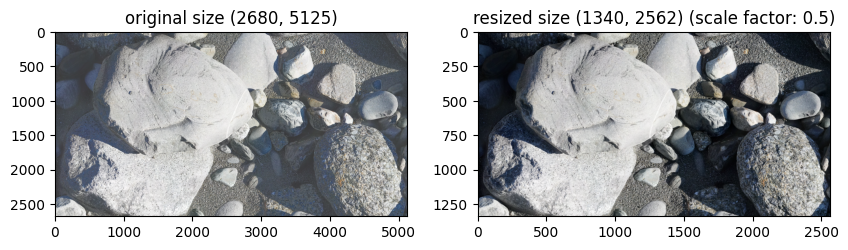

In [112]:
fxy=0.5
shrinked_image=cv2.resize(cropped_image, (0, 0), fx = fxy, fy = fxy)#, interpolation = cv2.INTER_AREA)
#inter area is weighted spatial average of window
fig,ax=plt.subplots(1,2,figsize=(10,20))
ax[0].imshow(clahe_image)
ax[0].set_title(f'original size {clahe_image.shape[:-1]}')
ax[1].imshow(shrinked_image)
ax[1].set_title(f'resized size {shrinked_image.shape[:-1]} (scale factor: {fxy})')
plt.show()

In [12]:
#clean gpu memory
gc.collect()
torch.cuda.empty_cache()

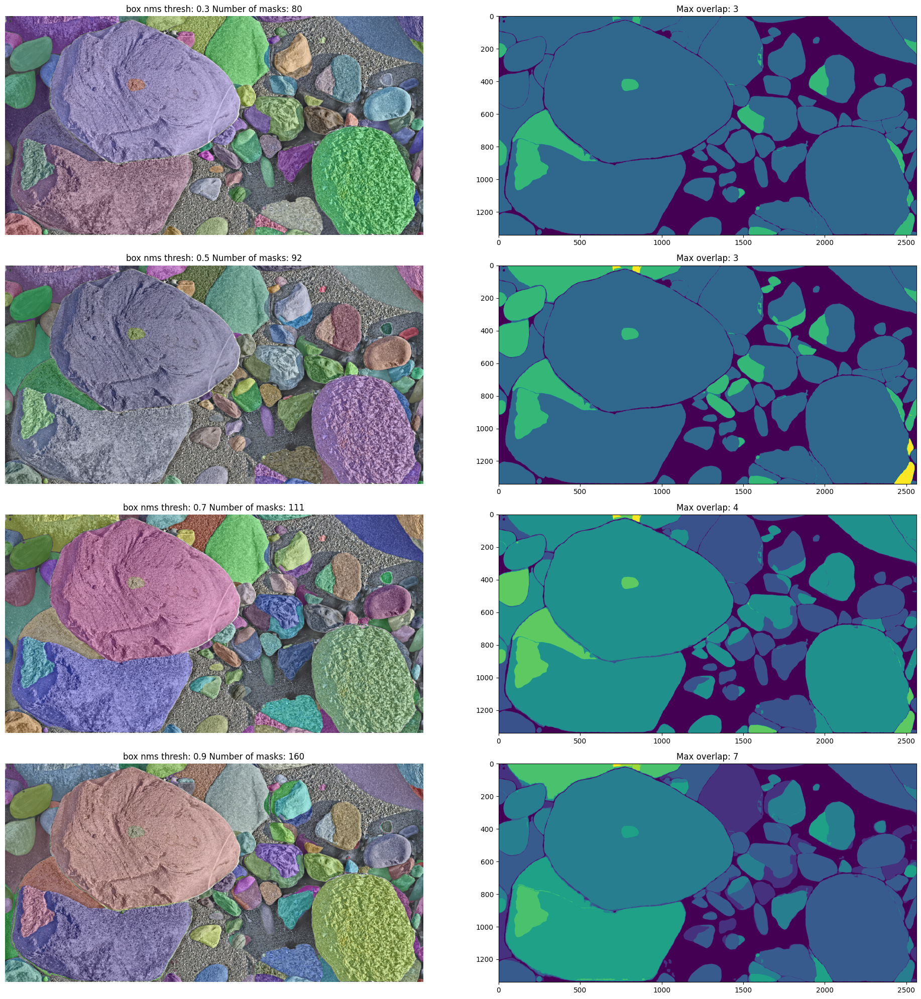

In [62]:
#parameter testing
temp_image=shrinked_image

var='box nms thresh'
test=[0.3,0.5,0.7,0.9]

fig, ax = plt.subplots(len(test),2,figsize=(20,20))
ax=ax.flatten()

#build generator
for i in np.arange(0,len(test),1):
    mask_generator = SamAutomaticMaskGenerator(
        model=sam,
        points_per_side=128,
        pred_iou_thresh=0.90,
        stability_score_thresh=0.95,#iou by varying cutoff in binary conversion
        box_nms_thresh=test[i],#The box IoU cutoff used by non-maximal suppression to filter duplicate masks
        crop_n_layers=0,#cut into 2**n crops
        crop_nms_thresh=0.5,#The box IoU cutoff used by non-maximal suppression to filter duplicate masks between crops
        crop_n_points_downscale_factor=1,
        crop_overlap_ratio=0,
        min_mask_region_area=100,
    )
    with torch.no_grad():
        masks = mask_generator.generate(temp_image)
    ax[i*2].imshow(temp_image)
    fnc.show_anns_mod_ax(masks, ax[i*2])
    ax[i*2].set_title(f'{var}: {test[i]} Number of masks: {len(masks)}')
    ax[i*2].axis('off')
    list_of_masks = [mask['segmentation'].astype(np.uint8) for mask in masks]
    ar_masks=np.stack(list_of_masks) 
    ax[i*2+1].imshow(np.sum(ar_masks,axis=0))
    ax[i*2+1].set_title(f'Max overlap: {np.unique(np.sum(ar_masks,axis=0)).max()}')       
plt.tight_layout()
plt.show()

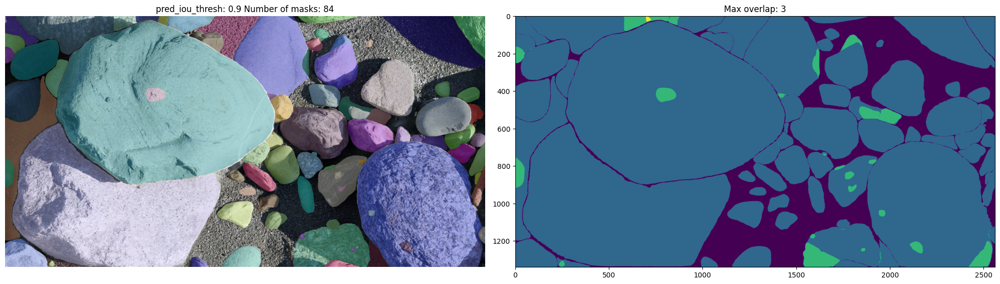

In [113]:
temp_image=shrinked_image

var='pred_iou_thresh'
test=[0.9]

fig, ax = plt.subplots(len(test),2,figsize=(20,20))
ax=ax.flatten()

#build generator
for i in np.arange(0,len(test),1):
    mask_generator = SamAutomaticMaskGenerator(
        model=sam,
        points_per_side=128,
        pred_iou_thresh=test[i],
        stability_score_thresh=0.95,#iou by varying cutoff in binary conversion
        box_nms_thresh=0.3,#The box IoU cutoff used by non-maximal suppression to filter duplicate masks
        crop_n_layers=0,#cut into 2**n crops
        crop_nms_thresh=0,#The box IoU cutoff used by non-maximal suppression to filter duplicate masks between crops
        crop_n_points_downscale_factor=1,
        crop_overlap_ratio=0,
        min_mask_region_area=2000,
    )
    with torch.no_grad():
        masks = mask_generator.generate(temp_image)
    ax[i*2].imshow(temp_image)
    fnc.show_anns_mod_ax(masks, ax[i*2])
    ax[i*2].set_title(f'{var}: {test[i]} Number of masks: {len(masks)}')
    ax[i*2].axis('off')
    list_of_masks = [mask['segmentation'].astype(np.uint8) for mask in masks]
    ar_masks=np.stack(list_of_masks) 
    ax[i*2+1].imshow(np.sum(ar_masks,axis=0))
    ax[i*2+1].set_title(f'Max overlap: {np.unique(np.sum(ar_masks,axis=0)).max()}')       
plt.tight_layout()
plt.show()

In [18]:
list_of_masks = [mask['segmentation'].astype(np.uint8) for mask in masks]
list_of_masks = [fnc.clean_mask(mask) for mask in list_of_masks]
ar_masks=np.stack(list_of_masks)
#flat 2d to 1d masks
ar_masks_flat=ar_masks.reshape((ar_masks.shape[0],ar_masks.shape[1]*ar_masks.shape[2]))

In [19]:
ar_masks_flat.shape

(81, 3433080)

In [34]:
#find pixel wise overlaps
list_overlap=[]
for i in range(ar_masks_flat.shape[1]):
    nz=np.nonzero(ar_masks_flat[:,i])[0]#for each pixel find out the idex of mask where the pixel was in a mask
    if len(nz)>1:#if there are overlap of mask
        if not any(np.array_equal(nz, arr) for arr in list_overlap):
            list_overlap.append(nz)
#list_overlap1=[ np.nonzero(ar_masks_flat[:,i])[0] for i in range(ar_masks_flat.shape[1]) if len(np.nonzero(ar_masks_flat[:,i])[0])>1]

In [49]:
#get intersection area(pixel) for each pair
list_overlap_intersection=[np.unique(np.sum([list_of_masks[i] for i in overlap],axis=0), return_counts=True)[1][-1] for overlap in list_overlap]

In [50]:
threshold=1000
list_overlap_threshold=[list_overlap[i] for i in range(len(list_overlap_intersection)) if list_overlap_intersection[i] > threshold]

In [51]:
len(list_overlap)

35

In [52]:
len(list_overlap_threshold)

15

In [ ]:
threshold=1000
for i in range(len(list_overlap_intersection)):
    if list_overlap_intersection[i] > threshold:
        plt.imshow(np.sum(np.stack([list_of_masks[i] for i in list_overlap[i]]),axis=0))
        plt.show()

In [54]:
checker=np.zeros(len(masks))
for gp in list_overlap_threshold:
    for i in gp:
        checker[i]+=1
remaining_ungrouped=np.max(np.unique(checker))

cleaned_groups=None#dummy to identify first run

while remaining_ungrouped>1:#keep groupping until there is no overlapping groups
    groups=[]

    if not cleaned_groups:#the first run
        temp_list_overlap=list_overlap_threshold.copy()
    else:#>2 run
        temp_list_overlap=cleaned_groups.copy()

    while len(temp_list_overlap)>1:
        temp_group=temp_list_overlap[0].copy()
        remaining=[]
        for i in np.arange(1,len(temp_list_overlap),1):
            num_common_val=len(np.intersect1d(temp_list_overlap[0],temp_list_overlap[i]))
            if num_common_val!=0:
                temp_group=np.hstack((temp_group,temp_list_overlap[i]))
            else:
                remaining.append(temp_list_overlap[i])
        temp_list_overlap=remaining.copy()
        groups.append(temp_group)
    groups.append(remaining[0])

    #remove duplicated index after stacking
    cleaned_groups=[np.unique(group) for group in groups]

    checker=np.zeros(len(masks))
    for gp in cleaned_groups:
        for i in gp:
            checker[i]+=1
    remaining_ungrouped=np.max(np.unique(checker))

In [61]:
np.unique(np.hstack(list_overlap))

array([ 0,  1,  3,  4,  7, 10, 11, 13, 14, 15, 17, 20, 21, 26, 27, 31, 35,
       36, 37, 39, 40, 43, 44, 45, 49, 50, 51, 54, 56, 57, 58, 59, 60, 61,
       64, 67, 69, 70, 71, 72, 73, 75, 76, 77, 78, 79, 80])

In [59]:
np.unique(np.hstack(cleaned_groups))

array([ 0,  1,  3,  4,  7, 10, 15, 17, 27, 31, 35, 43, 44, 45, 49, 50, 51,
       54, 56, 58, 60, 61, 64, 70, 71, 75, 76, 80])

In [58]:
print(f'{len(cleaned_groups)} groups found\n')
if len(np.unique(np.hstack(cleaned_groups)))==len(np.unique(np.hstack(list_overlap))):
    if np.sum(np.unique(np.hstack(cleaned_groups))==np.unique(np.hstack(list_overlap))):
        print('nothing missing')
    else:
        print('Warning: something missing')
else:
    print('Warning: total number not match')

13 groups found



In [62]:
cleaned_groups

[array([17, 49]),
 array([31, 60]),
 array([10, 61]),
 array([ 4, 15]),
 array([ 3, 58]),
 array([ 0, 35, 80]),
 array([54, 56]),
 array([ 7, 44]),
 array([ 1, 51]),
 array([43, 50, 64]),
 array([45, 71]),
 array([27, 75]),
 array([70, 76])]

In [63]:
for i in cleaned_groups[0]:
    print(i)
    print((regionprops(label(list_of_masks[i])))[0].area)

17
18453.0
49
2188.0


In [85]:
mask1=list_of_masks[62]
mask2=list_of_masks[51]
intersection = np.logical_and(mask1, mask2)

# Calculate the union
union = np.logical_or(mask1, mask2)

# Calculate the IoU
iou = np.sum(intersection) / np.sum(union)
iou
#base on l band check if these are bright side and shadow side and by comparing a b band see if they are identical?

0.005083668714255455

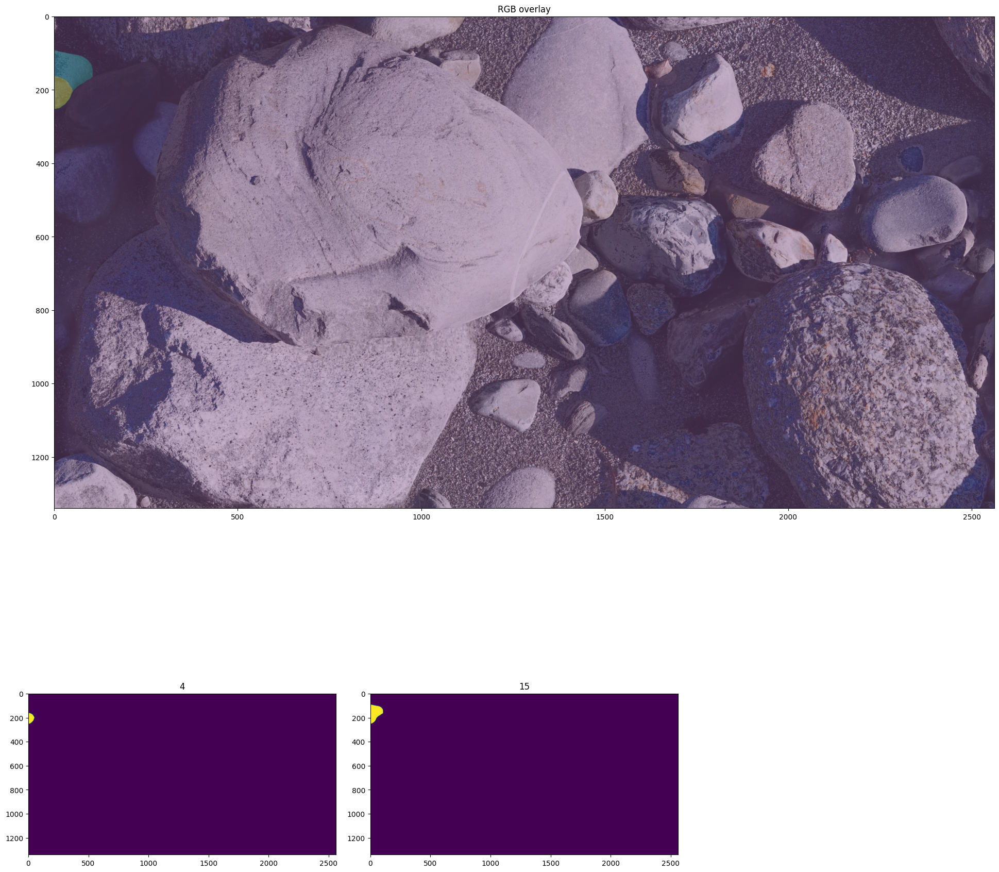

In [111]:
import matplotlib.gridspec as gridspec
k=3
# Create a figure
fig = plt.figure(figsize=(20, 20))

num_rows=int(np.ceil((len(cleaned_groups[k])/3)))+1
gs = gridspec.GridSpec(num_rows, 3, height_ratios=list((np.ones(num_rows).astype(int))))

ax_big = fig.add_subplot(gs[0, :])
ax_big.imshow(shrinked_image)
ax_big.imshow(np.sum(np.stack([list_of_masks[i] for i in cleaned_groups[k]]),axis=0), alpha=0.3)
ax_big.set_title('RGB overlay')

j=0
for i in range(len(cleaned_groups[k])):
    ax = fig.add_subplot(gs[(i//3)+1, j])
    ax.imshow(list_of_masks[cleaned_groups[k][i]])
    ax.set_title(f'{cleaned_groups[k][i]}')

    if j==2:
        j=0
    else:
        j+=1

plt.tight_layout()
plt.show()

In [89]:
mask1=list_of_masks[cleaned_groups[k][1]]
mask2=list_of_masks[cleaned_groups[k][6]]
intersection = np.logical_and(mask1, mask2)

np.sum(intersection)
#base on l band check if these are bright side and shadow side and by comparing a b band see if they are identical?

40

In [87]:
np.sum(mask1)

7807

In [119]:
target=60
overlaps_with_target=[]
for ls in list_overlap:
    if np.any(target == ls[0]):
        overlaps_with_target.append(ls[0])

In [120]:
overlaps_with_target=np.unique(np.hstack(overlaps_with_target))
overlaps_with_target=overlaps_with_target[overlaps_with_target != target]
overlaps_with_target

array([ 0,  1,  2, 17, 37, 44, 47, 56, 59])

In [135]:
np.unique(label(ar_masks[60]))

array([0, 1, 2, 3, 4])

In [143]:
labels = label(ar_masks[60])
regions = regionprops(labels)

# Sort regions by area
sorted_regions = sorted(regions, key=lambda x: x.area, reverse=True)

# Print sorted regions by area
for region in sorted_regions:
    print(f"Label: {region.label}, Area: {region.area}")

Label: 1, Area: 2826630.0
Label: 2, Area: 220.0
Label: 3, Area: 178.0
Label: 4, Area: 163.0


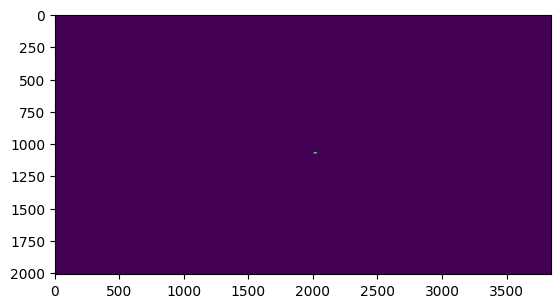

In [144]:
plt.imshow(label(ar_masks[60])==2)

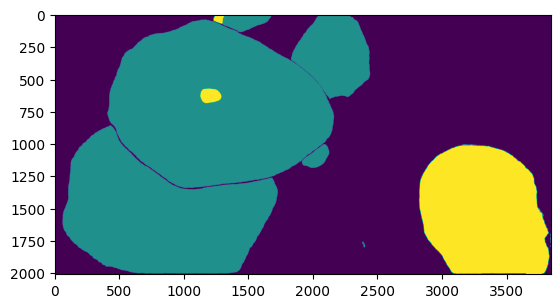

In [122]:
plt.imshow(np.sum(ar_masks[overlaps_with_target],axis=0))

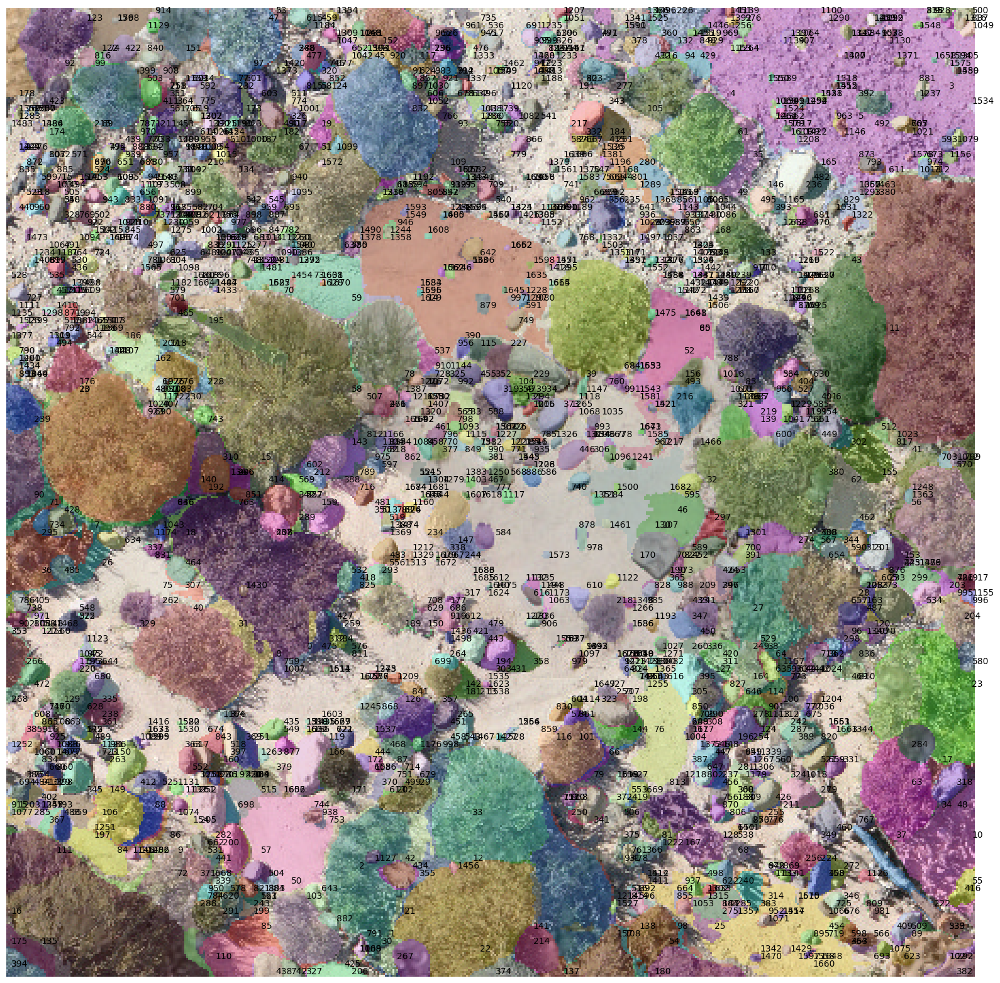

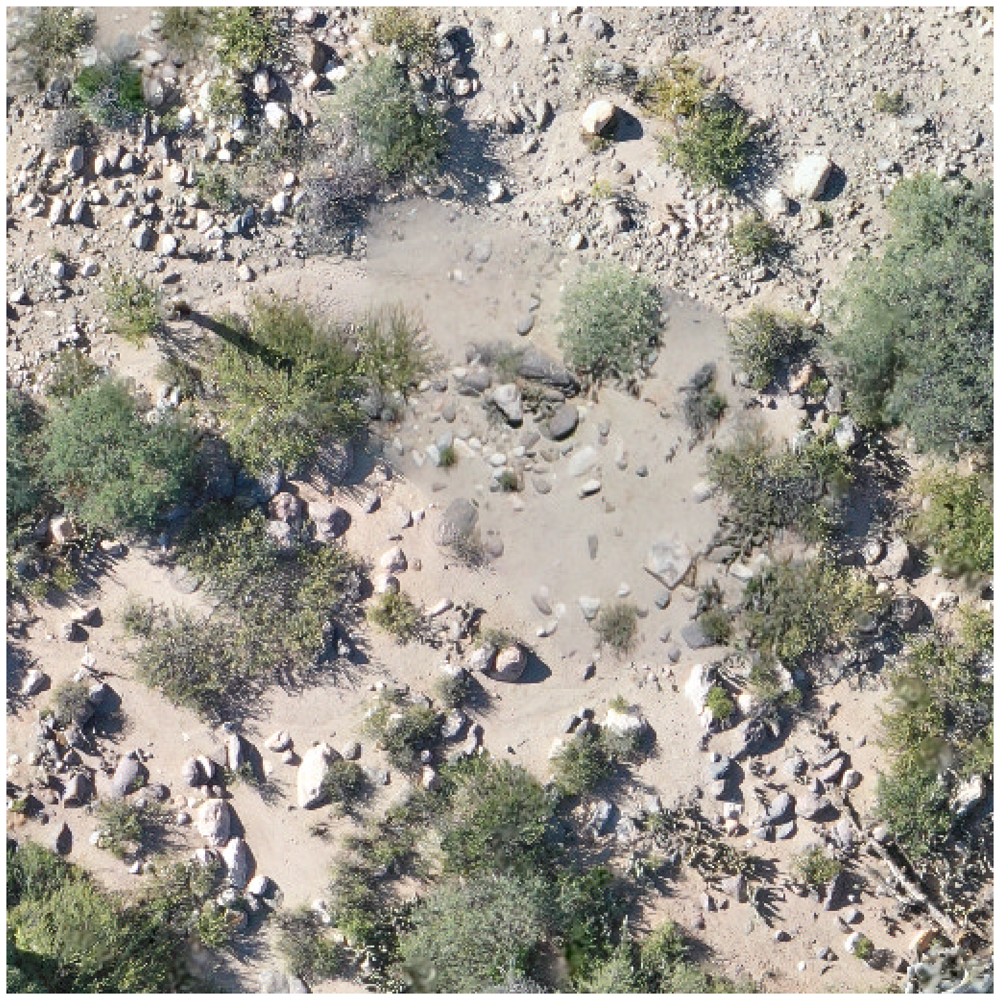

In [9]:
mask_generator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=128,
    pred_iou_thresh=0.75,
    stability_score_thresh=0.75,
    crop_n_layers=0,
    crop_n_points_downscale_factor=0,
    crop_overlap_ratio=0,
    min_mask_region_area=50,
)
masks = fnc.samplot(cropped_image, mask_generator)

In [11]:
fnc=reload(fnc)

In [10]:
model_list=clip.available_models()
print('Available clip models:')
for i, M in enumerate(model_list):
    print(f'{i}:' + M)
print("---------------")

Available clip models:
0:RN50
1:RN101
2:RN50x4
3:RN50x16
4:RN50x64
5:ViT-B/32
6:ViT-B/16
7:ViT-L/14
8:ViT-L/14@336px
---------------


In [ ]:
model_select=int(input("Select a model: "))
model, preprocess = clip.load(model_list[model_select], device=DEVICE)
print(model_list[model_select]+' loaded')

In [11]:
model, preprocess = clip.load(model_list[7], device=DEVICE)
print(model_list[7]+' loaded')

ViT-L/14 loaded


In [ ]:
labels_LSet01=["an aerial photo of a stone", "an aerial photo of a small pebble stone"
        , "an aerial photo of a piece of sand surface"
        , "an aerial photo of some green plants", "dead bush"
        , "an aerial photo of a shrub","an irregular green object", "a top-down photo of a bush", "an aerial photo of a bush"
        , "a top-down photo of a shrub", "an aerial photo of some bushes", "wood stick", "wood branch"
        , "an aerial photo of desert surface", "an aerial photo of a sandy ground"
        , "a photo of the top of a bush", "an aerial photo of a small bush"]

In [14]:
##label top

kmean_apply=False
WithBackground=False
BG='White'
#BG='Black

if (not WithBackground) or kmean_apply:
    if BG=='White':
        fill_value=255
    else:
        fill_value=0

#load image
pil_image = Image.fromarray(cropped_image)
numpy_array = np.array(pil_image)
if kmean_apply:
    numpy_array[kmean_mask==0]=fill_value

#define possible labels
labels=["an aerial photo of a stone", "an aerial photo of a small pebble stone"
        , "an aerial photo of a piece of sand surface"
        , "an aerial photo of some green plants", "dead bush"
        , "an aerial photo of a shrub","an irregular green object", "a top-down photo of a bush", "an aerial photo of a bush"
        , "a top-down photo of a shrub", "an aerial photo of some bushes", "wood stick", "wood branch"
        , "an aerial photo of desert surface", "an aerial photo of a sandy ground"
        , "a photo of the top of a bush", "an aerial photo of a small bush"]
text = clip.tokenize(labels).to(DEVICE)

#output
most_probables = []
probabilities = []
clip_probability_mask=np.zeros(cropped_image.shape[:-1])
    
#run prediction
for sg in tqdm(masks, desc='Processing', unit='segment'):
    sg_mask=sg['segmentation']

    #cropping
    notzero_indices = np.nonzero(sg_mask)
    if notzero_indices[0].shape[0]>10:
        x_min = np.min(notzero_indices[0]).astype(int)
        x_max = np.max(notzero_indices[0]).astype(int)
        y_min = np.min(notzero_indices[1]).astype(int)
        y_max = np.max(notzero_indices[1]).astype(int)
        if WithBackground:
            clip_masked_image=numpy_array[x_min-5:x_max+5, y_min-5:y_max+5,:]
        else:
            #masking
            masked_image = np.copy(numpy_array)
            masked_image[sg_mask == 0] = fill_value
            clip_masked_image=masked_image[x_min-5:x_max+5, y_min-5:y_max+5,:]

        #convert back to PIL
        if ((clip_masked_image.shape[0]!=0)&(clip_masked_image.shape[1]!=0)):
            preprocessed_pil_image = Image.fromarray(clip_masked_image)

            #predict
            pre_image = preprocess(preprocessed_pil_image).unsqueeze(0).to(DEVICE)
            most_porbable, probability = fnc.classify_and_return_notable(pre_image, text, labels, model)
            most_probables.append(int(most_porbable))
            probabilities.append(probability)
            
            if int(most_porbable)<=1:
                clip_probability_mask[sg_mask]=probability
        else:
            most_probables.append(np.nan)
            probabilities.append(np.nan)

Processing:   0%|          | 0/1687 [00:00<?, ?segment/s]/DATA/vito/.venv/lib/python3.8/site-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
Processing:  47%|████▋     | 790/1687 [00:35<00:37, 23.66segment/s]

Processing: 100%|██████████| 1687/1687 [01:13<00:00, 22.98segment/s]


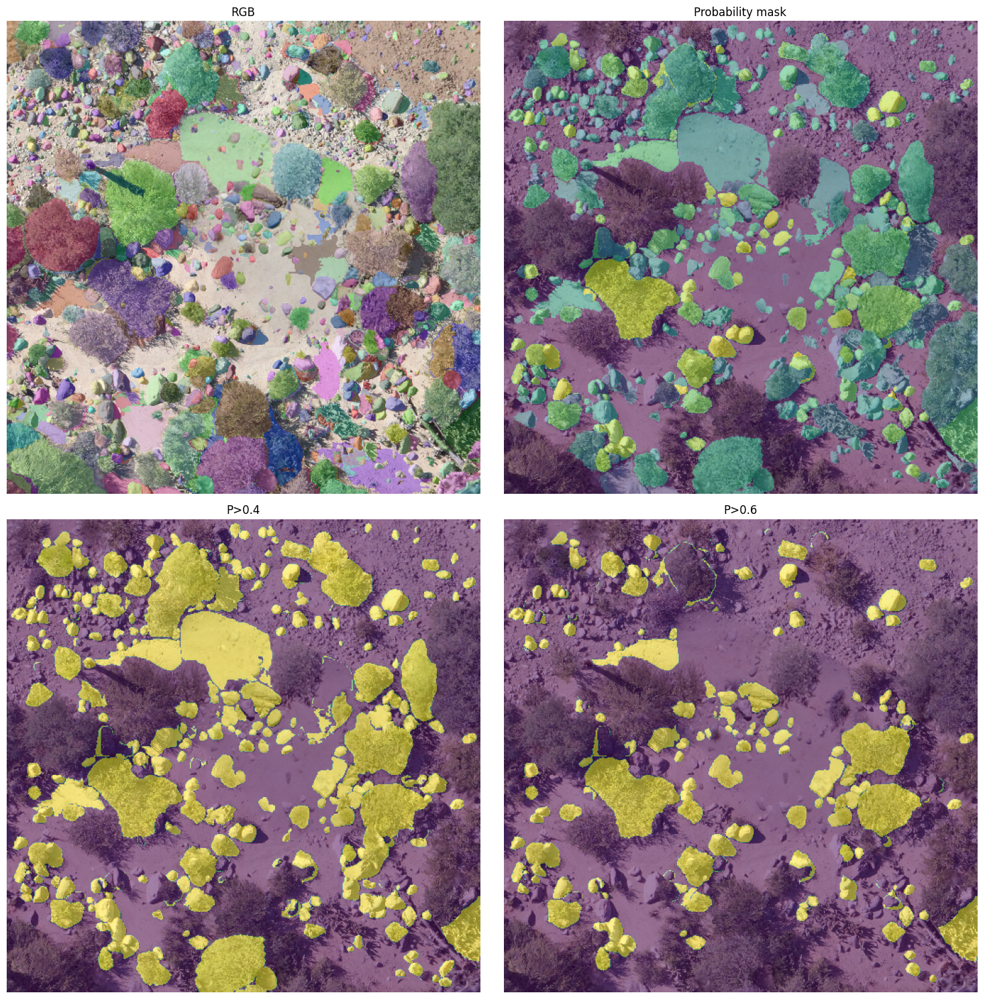

In [15]:
fnc.clip_plotting(cropped_image,clip_probability_mask, masks,0.4,0.6)

In [ ]:
labels_SSet01=["rock", "sand", "vegetation", "bushes", "desert", "ground"]

In [57]:
#label prob

kmean_apply=True
WithBackground=False
BG='White'
#BG='Black

if (not WithBackground) or kmean_apply:
    if BG=='White':
        fill_value=255
    else:
        fill_value=0

#load image
pil_image = Image.fromarray(cropped_image)
numpy_array = np.array(pil_image)
if kmean_apply:
    numpy_array[kmean_mask==0]=fill_value

#define possible labels
labels=["rock", "sand", "vegetation", "bushes", "desert", "ground"]
#labels=["bushes", "sand"]
text = clip.tokenize(labels).to(DEVICE)

#output
probabilities = []
clip_probability_mask=np.zeros(cropped_image.shape[:-1])
 
#run prediction
for sg in tqdm(masks, desc='Processing', unit='segment'):
    sg_mask=sg['segmentation']

    #cropping
    notzero_indices = np.nonzero(sg_mask)
    x_min = np.min(notzero_indices[0]).astype(int)
    x_max = np.max(notzero_indices[0]).astype(int)
    y_min = np.min(notzero_indices[1]).astype(int)
    y_max = np.max(notzero_indices[1]).astype(int)
    if WithBackground:
        clip_masked_image=numpy_array[x_min-5:x_max+5, y_min-5:y_max+5,:]
    else:
        #masking
        masked_image = np.copy(numpy_array)
        masked_image[sg_mask == 0] = fill_value
        clip_masked_image=masked_image[x_min-5:x_max+5, y_min-5:y_max+5,:]


    #convert back to PIL
    if ((clip_masked_image.shape[0]!=0)&(clip_masked_image.shape[1]!=0)):
        preprocessed_pil_image = Image.fromarray(clip_masked_image)

        #predict
        pre_image = preprocess(preprocessed_pil_image).unsqueeze(0).to(DEVICE)
        with torch.no_grad():
            image_features = model.encode_image(pre_image)
            text_features = model.encode_text(text)
    
            logits_per_image, logits_per_text = model(pre_image, text)
            probs = logits_per_image.softmax(dim=-1).cpu().numpy()
            clip_probability_mask[sg_mask]=probs[0][0]
    else:
        probabilities.append(np.nan)

Processing:   0%|          | 0/1687 [00:00<?, ?segment/s]

Processing: 100%|██████████| 1687/1687 [01:01<00:00, 27.22segment/s]


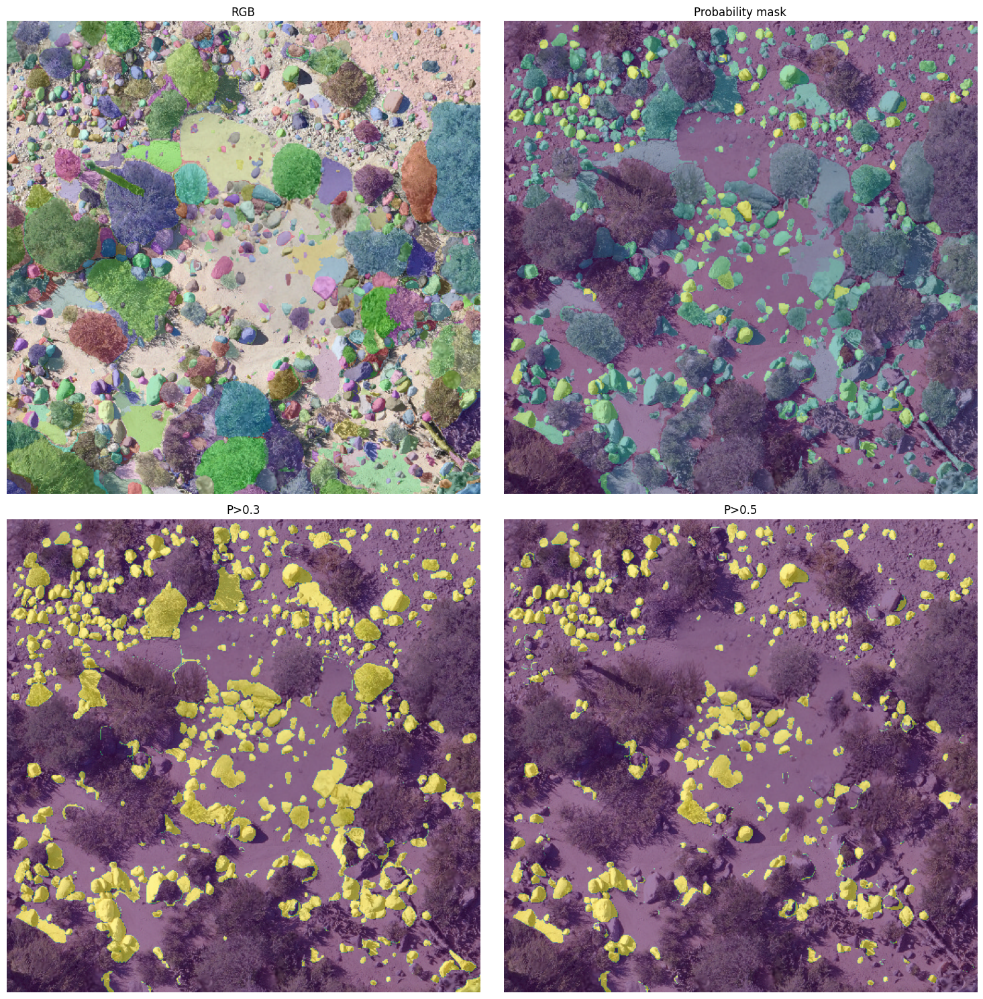

In [59]:
fnc.clip_plotting(cropped_image,clip_probability_mask, masks,0.3,0.5)

In [131]:
fnc=reload(fnc)

In [62]:
imagenet_templates = [
    'a bad photo of a {}.',
    'a photo of many {}.',
    'a sculpture of a {}.',
    'a photo of the hard to see {}.',
    'a low resolution photo of the {}.',
    'a rendering of a {}.',
    'graffiti of a {}.',
    'a bad photo of the {}.',
    'a cropped photo of the {}.',
    'a tattoo of a {}.',
    'the embroidered {}.',
    'a photo of a hard to see {}.',
    'a bright photo of a {}.',
    'a photo of a clean {}.',
    'a photo of a dirty {}.',
    'a dark photo of the {}.',
    'a drawing of a {}.',
    'a photo of my {}.',
    'the plastic {}.',
    'a photo of the cool {}.',
    'a close-up photo of a {}.',
    'a black and white photo of the {}.',
    'a painting of the {}.',
    'a painting of a {}.',
    'a pixelated photo of the {}.',
    'a sculpture of the {}.',
    'a bright photo of the {}.',
    'a cropped photo of a {}.',
    'a plastic {}.',
    'a photo of the dirty {}.',
    'a jpeg corrupted photo of a {}.',
    'a blurry photo of the {}.',
    'a photo of the {}.',
    'a good photo of the {}.',
    'a rendering of the {}.',
    'a {} in a video game.',
    'a photo of one {}.',
    'a doodle of a {}.',
    'a close-up photo of the {}.',
    'a photo of a {}.',
    'the origami {}.',
    'the {} in a video game.',
    'a sketch of a {}.',
    'a doodle of the {}.',
    'a origami {}.',
    'a low resolution photo of a {}.',
    'the toy {}.',
    'a rendition of the {}.',
    'a photo of the clean {}.',
    'a photo of a large {}.',
    'a rendition of a {}.',
    'a photo of a nice {}.',
    'a photo of a weird {}.',
    'a blurry photo of a {}.',
    'a cartoon {}.',
    'art of a {}.',
    'a sketch of the {}.',
    'a embroidered {}.',
    'a pixelated photo of a {}.',
    'itap of the {}.',
    'a jpeg corrupted photo of the {}.',
    'a good photo of a {}.',
    'a plushie {}.',
    'a photo of the nice {}.',
    'a photo of the small {}.',
    'a photo of the weird {}.',
    'the cartoon {}.',
    'art of the {}.',
    'a drawing of the {}.',
    'a photo of the large {}.',
    'a black and white photo of a {}.',
    'the plushie {}.',
    'a dark photo of a {}.',
    'itap of a {}.',
    'graffiti of the {}.',
    'a toy {}.',
    'itap of my {}.',
    'a photo of a cool {}.',
    'a photo of a small {}.',
    'a tattoo of the {}.',
]


In [87]:
#clip zero shot
image_classes = ["stone or rock"
                 , "wood branch"
                 #, "plant"
                 #, "green plant"
                 , "dry bush", "shrub", "bush", "green bush"
                 , "irregular clip of desert floor"
                 , "irregular clip of sandy surface"
                 , "gravel and sand"
                 ]


image_templates = [
    'an aerial photo of a {}.',
    'a clip of a {}.',
    'a top down photo of a {}.',
    'a pixelated photo of the {}.',
    'a blurry photo of a {}.',
    'a photo of some {}.',
    'a bad photo of a {}.',
    'a low resolution photo of a {}.',
    'a photo of a small {}.',
    'a photo of a big {}.',
    'a {} with a black background.',
    'a {} on a black board.',
]

zeroshot_weights = fnc.zeroshot_classifier(image_classes, image_templates, DEVICE, model)

100%|██████████| 9/9 [00:00<00:00, 92.50it/s]


Processing: 100%|██████████| 1687/1687 [00:30<00:00, 55.41segment/s]


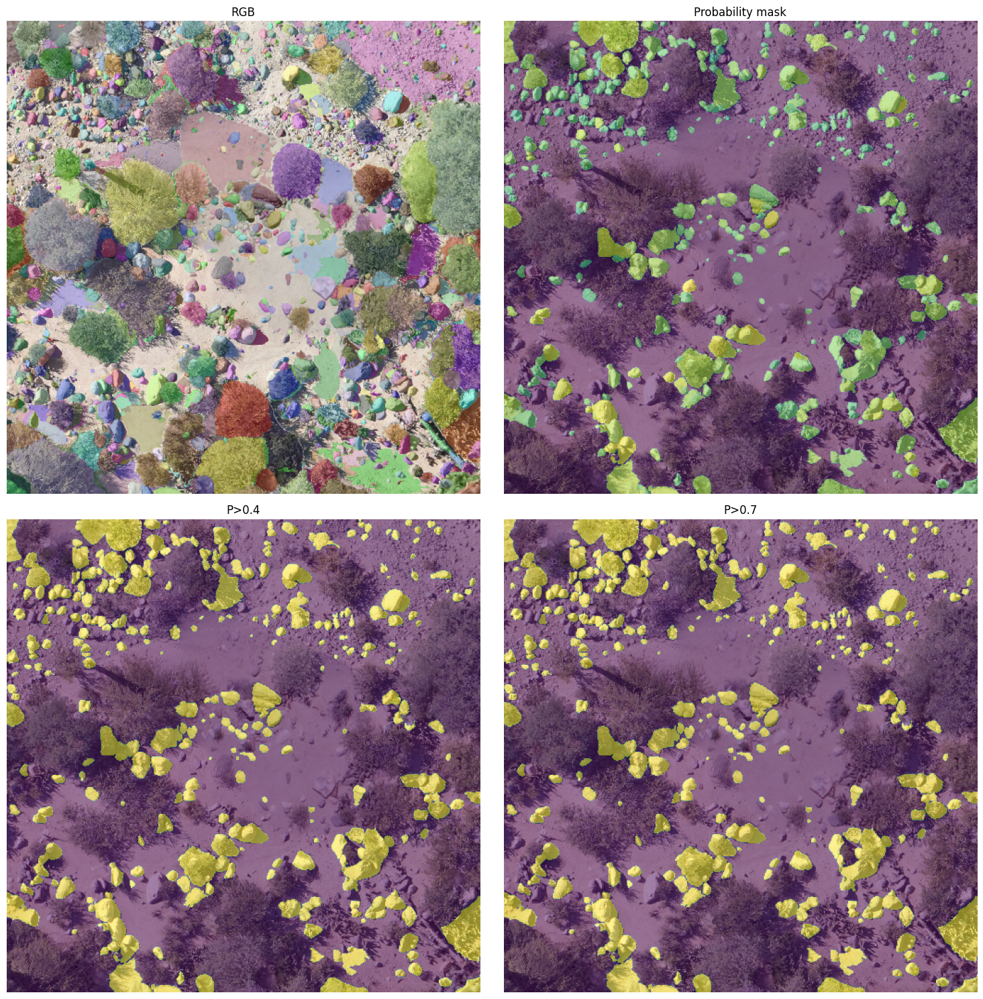

In [88]:
fnc=reload(fnc)
crop_size=512
pebble_index = 0
clip_top1_probability_mask, clip_probability_mask,_,_=fnc.clipzeroshot(cropped_image, masks, zeroshot_weights
                                                                       , crop_size, pebble_index, model
                                                                       , DEVICE, preprocess
                                                                       #, WithBackground=False
                                                                       , WithBackground=True
                                                                       #, pre_mask=kmean_mask)
                                                                       , pre_mask=None)

#save output
#np.save(OutDIR+'clip_probability_mask.npy', clip_probability_mask)
#np.save(OutDIR+'clip_most_probables.npy', most_probables)

fnc.clip_plotting(numpy_array,clip_top1_probability_mask, masks,0.4,0.7)
#fnc.clip_plotting(numpy_array,clip_probability_mask, masks)

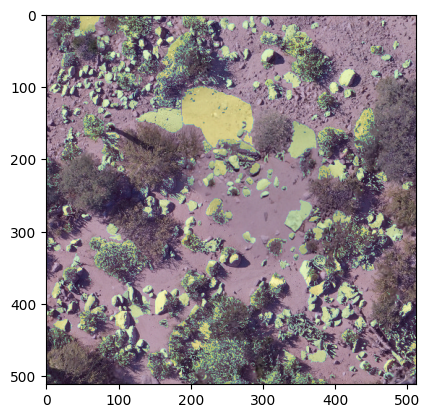

In [35]:
test=clip_top1_probability_mask.copy()
test[kmean_mask==0]=0
plt.imshow(cropped_image)
plt.imshow(test, alpha=0.3)
plt.show()

In [58]:
pebble_index = 0
#load image
pil_image = Image.fromarray(cropped_image)
numpy_array = np.array(pil_image)

#define possible labels
text = clip.tokenize(['a blurry photo of white stone']).to(DEVICE)

#output
imgs=[]
most_probables = []
probabilities = []
clip_probability_mask=np.zeros(cropped_image.shape[:-1])
clip_pebble_top1_probability_mask=np.zeros(cropped_image.shape[:-1])

#run prediction
for sg in tqdm(masks, desc='Processing', unit='segment'):
    sg_mask=sg['segmentation']

    #masking
    masked_image = np.copy(numpy_array)
    masked_image[sg_mask == 0] = 0

    #cropping
    notzero_indices = np.nonzero(masked_image)
    x_min = np.min(notzero_indices[0]).astype(int)
    x_max = np.max(notzero_indices[0]).astype(int)
    y_min = np.min(notzero_indices[1]).astype(int)
    y_max = np.max(notzero_indices[1]).astype(int)
    clip_masked_image=masked_image[x_min-10:x_max+10, y_min-10:y_max+10,:]

    #convert back to PIL
    if ((clip_masked_image.shape[0]!=0)&(clip_masked_image.shape[1]!=0)):
        preprocessed_pil_image = Image.fromarray(clip_masked_image)

        #predict
        imgs.append(preprocess(preprocessed_pil_image))#.unsqueeze(0))
        
with torch.no_grad():
  #prediction with one prompt, several images. We need to stack the images together
    logits_per_image, logits_per_text = model(torch.stack(imgs).to(DEVICE),text)
    probs = logits_per_text.softmax(dim=-1).cpu().numpy()

Processing:   6%|▌         | 97/1565 [00:00<00:12, 120.02segment/s]

Processing: 100%|██████████| 1565/1565 [00:12<00:00, 129.30segment/s]


In [59]:
clip_pebble_probability_mask=np.zeros(cropped_image.shape[:-1])
i=0
#run prediction
for sg in tqdm(masks, desc='Processing', unit='segment'):
    sg_mask=sg['segmentation']

    #masking
    masked_image = np.copy(numpy_array)
    masked_image[sg_mask == 0] = 0

    #cropping
    notzero_indices = np.nonzero(masked_image)
    x_min = np.min(notzero_indices[0]).astype(int)
    x_max = np.max(notzero_indices[0]).astype(int)
    y_min = np.min(notzero_indices[1]).astype(int)
    y_max = np.max(notzero_indices[1]).astype(int)
    clip_masked_image=masked_image[x_min-10:x_max+10, y_min-10:y_max+10,:]

    #convert back to PIL
    if ((clip_masked_image.shape[0]!=0)&(clip_masked_image.shape[1]!=0)):
        clip_pebble_probability_mask[sg_mask] = probs[0][i]
        i+=1

Processing: 100%|██████████| 1565/1565 [00:10<00:00, 143.24segment/s]
